In [147]:
from PIL import Image
import numpy as np
import pandas as pd
from skimage import color
import matplotlib.pyplot as plt
from sklearn.cluster import MeanShift, KMeans
wi = 256
testnum = 4
def readimg(path) :
    img = Image.open(path)
    img = img.resize((wi,wi))
    img_rgb = img.convert('RGB')
    im_matrix = np.array(img_rgb)

    return im_matrix

def readimgYUV(path) :
    img = Image.open(path)
    img_yuv = img.convert('YCbCr')
    im_matrix = np.array(img_yuv)
    return im_matrix

def plot_gallery3(images, titles, h, w, n_row=1, n_col=2):
    """Helper function to plot a gallery of portraits"""
    plt.figure(figsize=(4 * n_col, 5 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    
    images = color.lab2rgb(images)
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images[i].reshape((h, w,3)))
        plt.title(titles[i], size=12)
        plt.xticks(())
        plt.yticks(())

In [148]:
imgArr = []

for i in range (1,testnum) :
    imgArr.append(color.rgb2lab(readimg(f'test/{i}.jpg').reshape(-1,3)))
print(imgArr)

[array([[ 43.7262686 ,   4.35356031, -42.5524896 ],
       [ 43.7262686 ,   4.35356031, -42.5524896 ],
       [ 43.87874364,   5.12893503, -42.88991251],
       ...,
       [ 48.16726005,  -4.47888244, -29.05794729],
       [ 51.24955814,  -3.06749347, -28.28199   ],
       [ 51.3265236 ,  -2.13654604, -31.06493673]]), array([[ 27.44864131,  10.90120491, -39.59697491],
       [ 27.48303037,  11.02291786, -39.53980375],
       [ 27.51861824,  11.14855073, -39.48064305],
       ...,
       [  6.71038787,  -2.80902131,   2.41594035],
       [  6.82828935,  -2.2067705 ,   2.00370424],
       [  6.34414852,  -2.31146752,   2.44996542]]), array([[ 8.88749748e+01,  3.58117174e-01, -9.72025092e-01],
       [ 8.87999742e+01,  2.23143462e-02, -1.09066198e+00],
       [ 8.88749748e+01,  3.58117174e-01, -9.72025092e-01],
       ...,
       [ 5.19305905e+00,  3.75527797e+00,  2.87338378e+00],
       [ 3.25760981e+00,  9.50531101e-01,  1.20107643e+00],
       [ 3.04620969e+00,  2.45753120e-03,  8.67

[[ 27.44864131  10.90120491 -39.59697491]
 [ 27.48303037  11.02291786 -39.53980375]
 [ 27.51861824  11.14855073 -39.48064305]
 ...
 [  6.71038787  -2.80902131   2.41594035]
 [  6.82828935  -2.2067705    2.00370424]
 [  6.34414852  -2.31146752   2.44996542]]


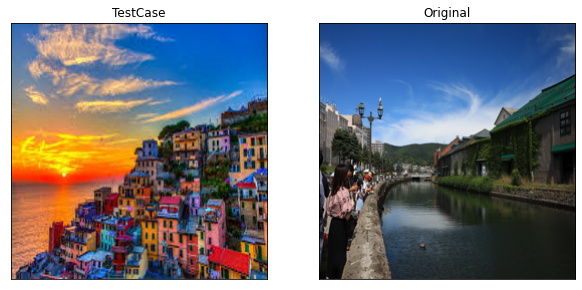

In [149]:
plot_gallery3([imgArr[0],imgArr[1]], ["TestCase","Original","2D DFT"], wi, wi)
print(imgArr[1])


In [150]:
def shiftplot(target, k) :
    ms = MeanShift(bandwidth=k, bin_seeding=True).fit(target)
    labels = ms.labels_
    cluster_centers = ms.cluster_centers_

    labels_unique = np.unique(labels)
    n_clusters_ = len(labels_unique)

    print("number of estimated clusters : %d" % n_clusters_)

    # #############################################################################
    # Plot result
    import matplotlib.pyplot as plt
    from itertools import cycle
    
    fig = plt.figure(figsize=(12, 6))
    ax = plt.axes(projection='3d')
    colors = cycle('bgrcmykbgrcmykbgrcmykbgrcmyk')
    for k, col in zip(range(n_clusters_), colors):
        my_members = labels == k
        cluster_center = cluster_centers[k]
        ax.scatter(target[my_members, 0], target[my_members, 1], target[my_members, 2])
        #plt.plot(target[my_members, 0], target[my_members, 1], target[my_members, 2], col + '.')
        #plt.plot(cluster_center[0], cluster_center[1], cluster_center[2], 'o', markerfacecolor=col,
        #        markeredgecolor='k', markersize=14)
    plt.title('Estimated number of clusters: %d' % n_clusters_)
    plt.show()
    return (ms, n_clusters_)
def kmeanplot(target, k) :
    ms = KMeans(n_clusters=k).fit(target)
    labels = ms.labels_
    cluster_centers = ms.cluster_centers_

    labels_unique = np.unique(labels)
    n_clusters_ = len(labels_unique)

    print("number of estimated clusters : %d" % n_clusters_)

    # #############################################################################
    # Plot result
    import matplotlib.pyplot as plt
    from itertools import cycle
    
    fig = plt.figure(figsize=(12, 6))
    ax = plt.axes(projection='3d')
    colors = cycle('bgrcmykbgrcmykbgrcmykbgrcmyk')
    for k, col in zip(range(n_clusters_), colors):
        my_members = labels == k
        cluster_center = cluster_centers[k]
        ax.scatter(target[my_members, 0], target[my_members, 1], target[my_members, 2])
        #plt.plot(target[my_members, 0], target[my_members, 1], target[my_members, 2], col + '.')
        #plt.plot(cluster_center[0], cluster_center[1], cluster_center[2], 'o', markerfacecolor=col,
        #        markeredgecolor='k', markersize=14)
    plt.title('Estimated number of clusters: %d' % n_clusters_)
    plt.show()
    return ms

In [151]:
def transformation(original, k) :
    (ms, n) = shiftplot(original, k)
    recover = []
    for elem in ms.labels_ :
        recover.append(ms.cluster_centers_[elem])
    plot_gallery3([original, recover], ["Original","Recover by Mean shift clustering"], wi, wi)
    return (ms, n)
def transformationKmeans(original,k) :
    ms = kmeanplot(original, k)
    recover = []
    for elem in ms.labels_ :
        recover.append(ms.cluster_centers_[elem])
    plot_gallery3([original, recover], ["Original","Recover by K-means clustering"], wi, wi)

number of estimated clusters : 6


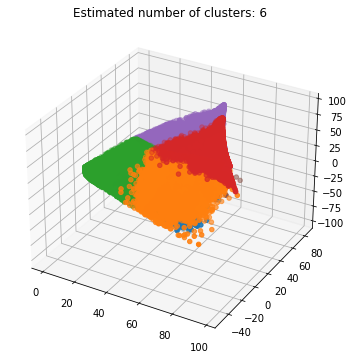

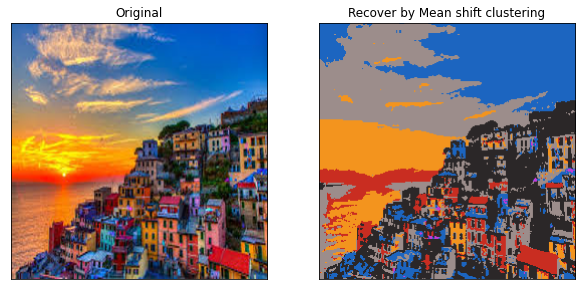

In [152]:
(a, b) = transformation(imgArr[0], 20)

number of estimated clusters : 6


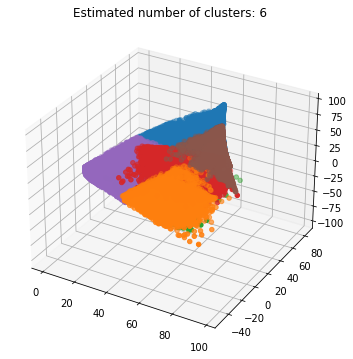

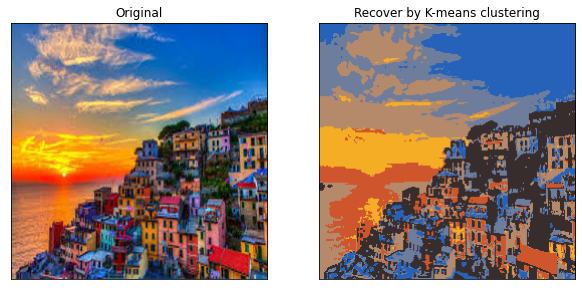

In [153]:
transformationKmeans(imgArr[0],b)